# Ciclo Diesel

In [18]:

# importação das bibliotecas Numpy, Matplotlib e Seaborn e do interpretador interativo.
import warnings
warnings.simplefilter(action = 'ignore', category = FutureWarning)
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt 
import matplotlib.ticker as mticker
sns.set(style = 'darkgrid')
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

In [19]:
# Valor de gama, o coeficiente de expansão adiabática. Ele exprime a razão entre a capacidade térmica
# a pressão constante (Cp) e a capacidade térmica a volume constante (Cv), para um gás ideal.
# gamma = Cp/Cv = 1.4 para o ar a 20ºC (gás diatômico ideal) .
gamma = 1.4 

# Vamos escolher três valores diferentes de volume de gás para calcular as trajetórias dos processos.
# O ponto 1 = (P1, V1) define o início do ciclo. Os valores e as unidades adotados são arbitrários e
# faremos nR = 1, por simplicidade.
V1 = V4 = 4.0
V2 = 1.0
V3 = 1.8

In [20]:
# Ponto 1: Início do primeiro processo - compressão adiabática do gás. 
# No Ponto 1 do ciclo, o volume do gás é V1 e a pressão é P1:
# Para um processo adiabático, P*V^gamma = constante, então P2*V2^gamma = P1*V1^gamma. 
# Podemos encontrar o valor da pressão P2 usando os valores dos volumes V1 e V2, conhecendo P1.
T1 = 2.0  # Temperatura no Ponto 1 do Diagrama PV.
P1 = T1 / V1  # Pressão no Ponto 1 do Diagrama PV.
# Ponto 2: Final do primeiro processo - compressão adiabática do gás. (T1≠T2).
# Gerando os pontos para a curva que representa a expansão adiabática do gás.
V_comp_adiabatica = np.linspace(V1, V2, 100)
P_comp_adiabatica = P1 * ((V1 / V_comp_adiabatica) ** gamma)

V_A = V_comp_adiabatica
P_A = P_comp_adiabatica


In [21]:
# Ponto 2: Final do primeiro processo - expansão adiabática do gás (T1≠T2).
T2 = T1 * (V1 / V2)**(gamma-1)
# Para um processo adiabático, P*V^gamma = constante, então P2*V2^gamma = P1*V1^gamma.
P2 = P1 * (V1 / V2) ** gamma 
# Ponto 2: Início do segundo processo - expansão isobárica do gás. 
P3 = P2
# Gerando os pontos para a curva que representa a expansão isobárica do gás.
V_exp_isobarica = np.linspace(V2, V3, 100)
P_exp_isobarica = np.linspace(P2, P3, 100)

V_B = V_exp_isobarica
P_B = P_exp_isobarica

In [22]:
# Ponto 3, final do segundo processo - expansão isobárica do gás. Vamos usar a equação 
# de estado dos gases ideais: PV = nRT, com nR = 1, por simplicidade. Logo: PV = T.
# No Ponto 3 do ciclo, o volume do gás é V3 e a pressão é P3.
T3 = T2 * (V3 / V2)
# Ponto 3, início do terceiro processo - expansão adiabática do gás.
# Para um processo adiabático, P*V^gamma = constante, então P3*V3^gamma = P2*V2^gamma. 
# Podemos encontrar o valor da pressão P4 usando os valores dos volumes V3 e V4, conhecendo P3.
P4 = P3 * (V3 / V4) ** gamma
# A temperatura no Ponto 4 é dada pela relação T*V^(gamma-1) = constante (expansão adiabática):
T4 = T3 * (V3 / V4)**(gamma-1)
# Gerando os pontos para a curva que representa a expansão adiabática do gás.
V_exp_adiabatica = np.linspace(V3, V4, 100)
P_exp_adiabatica = P3 * ((V3 / V_exp_adiabatica) ** gamma)

V_C = V_exp_adiabatica
P_C = P_exp_adiabatica

In [23]:
# Ponto 4: Início do terceiro processo: resfriamento isocórico (volume constante) do gás. 
# No Ponto 4 do ciclo, a pressão é P4 e a temperatura é T4. 
# No ponto 1 do ciclo, a temperatura será T1, menor que T4.
# Para um processo isocórico ou isovolumétrico (com volume constante), P4*T3 = P3*T4.
P1 = P4 * T1 / T4
# Gerando os pontos para a curva que representa o resfriamento isocórico do gás.
P_descomp_isocorica = np.linspace(P4, P1, 100)
V_descomp_isocorica = np.linspace(V4, V1, 100)

V_D = P_descomp_isocorica
P_D = V_descomp_isocorica

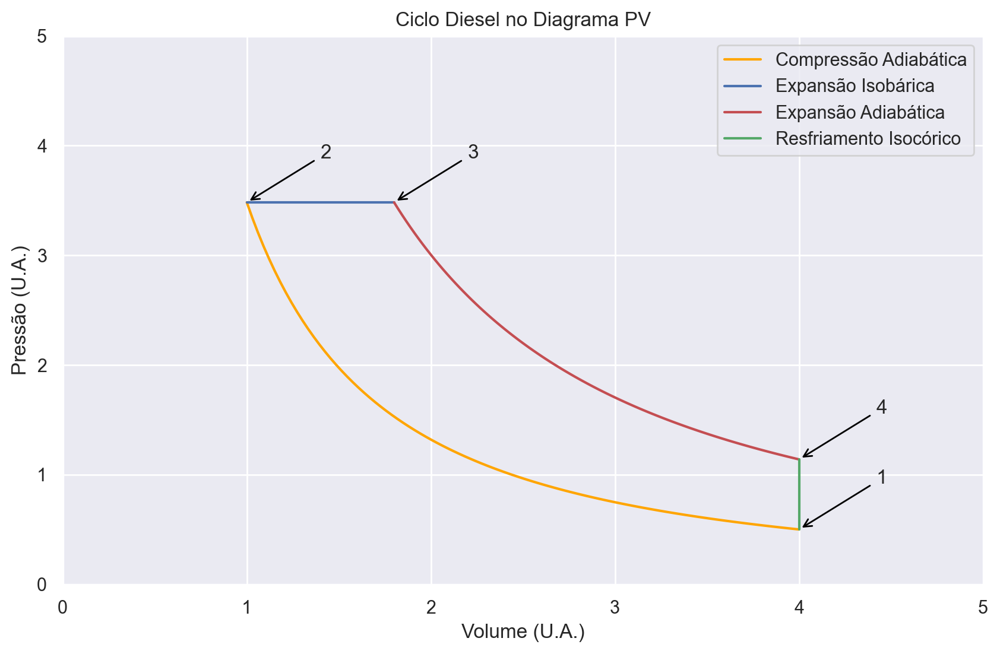

In [24]:
# Plotagem do diagrama PV.
plt.subplots(1, 1, figsize = (10, 6), dpi = 200)
plt.plot(V_comp_adiabatica, P_comp_adiabatica, 'orange', label = 'Compressão Adiabática')
plt.plot(V_exp_isobarica, P_exp_isobarica, 'b', label = 'Expansão Isobárica')
plt.plot(V_exp_adiabatica, P_exp_adiabatica, 'r', label = 'Expansão Adiabática')
plt.plot(V_descomp_isocorica, P_descomp_isocorica, 'g', label = 'Resfriamento Isocórico')
plt.xlabel('Volume (U.A.)')
plt.ylabel('Pressão (U.A.)')
plt.xlim((0, 5.0))
plt.ylim((0, 5.0))
plt.title('Ciclo Diesel no Diagrama PV')
plt.legend()
plt.grid(True)
# Setas indicando os inícios dos processos do ciclo.
plt.annotate('1', (V1, P1), (V1 + 0.42, P1 + 0.42), arrowprops = dict(arrowstyle = '->', color = 'black'), fontsize = 12)
plt.annotate('2', (V2, P2), (V2 + 0.4, P2 + 0.4), arrowprops = dict(arrowstyle = '->', color = 'black'), fontsize = 12)
plt.annotate('3', (V3, P3), (V3 + 0.4, P3 + 0.4), arrowprops = dict(arrowstyle = '->', color = 'black'), fontsize = 12)
plt.annotate('4', (V4, P4), (V4 + 0.42, P4 + 0.42), arrowprops = dict(arrowstyle = '->', color = 'black'), fontsize = 12)
plt.show()

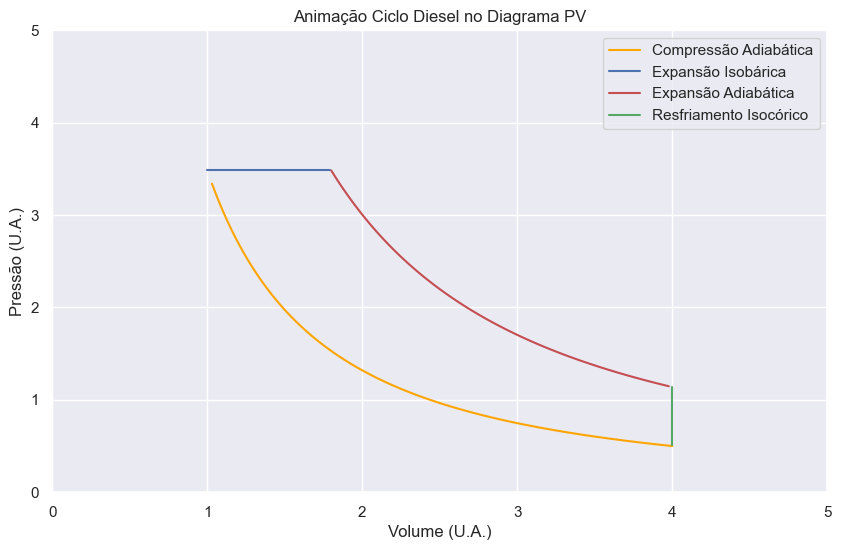

In [26]:
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

plt.rcParams['animation.embed_limit'] = 256
fig, ax = plt.subplots(figsize=(10, 6))
ax.set_ylim(0, 5)
ax.set_xlim(0, 5) 
ax.set_xlabel('Volume (U.A.)')
ax.set_ylabel('Pressão (U.A.)')
ax.set_title('Animação Ciclo Diesel no Diagrama PV')

V_A = V_comp_adiabatica
P_A = P_comp_adiabatica
V_B = V_exp_isobarica
P_B = P_exp_isobarica
V_C = V_exp_adiabatica
P_C = P_exp_adiabatica
V_D = V_descomp_isocorica
P_D = P_descomp_isocorica


# Inicializando as curvas como linhas vazias
line_A, = ax.plot([], [], 'orange', label = 'Compressão Adiabática')
line_B, = ax.plot([], [], 'b', label = 'Expansão Isobárica')
line_C, = ax.plot([], [], 'r', label = 'Expansão Adiabática')
line_D, = ax.plot([], [], 'g', label = 'Resfriamento Isocórico')


# Adicionando a legenda e a grade
ax.legend()
ax.grid(True)

# Função de inicialização, chamada apenas uma vez
def init():
    line_A.set_data([], [])
    line_B.set_data([], [])
    line_C.set_data([], [])
    line_D.set_data([], [])
    return line_A, line_B, line_C, line_D

# Função de animação
def animate(frame):
    # Atualizando os dados das curvas
    if frame < len(V_A):
        line_A.set_data(V_A[:frame], P_A[:frame])
    elif frame < len(V_A) + len(V_B):
        line_B.set_data(V_B[:frame-len(V_A)], P_B[:frame-len(V_A)])
    elif frame < len(V_A) + len(V_B) + len(V_C):
        line_C.set_data(V_C[:frame-(len(V_A)+len(V_B))], P_C[:frame-(len(V_A)+len(V_B))])
    else:
        line_D.set_data(V_D[:frame-(len(V_A)+len(V_B)+len(V_C))], P_D[:frame-(len(V_A)+len(V_B)+len(V_C))])

    return line_A, line_B, line_C, line_D

# Configurando a animação
total_frames = len(V_A) + len(V_B) + len(V_C) + len(V_D)
ani = FuncAnimation(fig, animate, frames=total_frames, init_func=init, blit=True, interval=100)

# Exibindo a animação usando JSAnimation
HTML(ani.to_jshtml())
